# ------- Machine Learning with TensorFlow Project: Istanbul or Taipei ?-----------


## -------------------------------- Jerry Hsu and Aslihan Demirkaya -----------------------------------

### Project Objective:
This project is aimed to train the machine to differentiate between the cities "Istanbul" and "Taipei" when a picture of those cities is given as an input. We picked this problem because we wanted to have experience in working with image data. We have worked on projects with structured data in other data science classes but we have never worked on unstructured data before. Working with images and those images being from our home cities have been the motivating factors. The problem seems fun but tough. By using Convolutional Deep Neural Networks, we aim to beat the 50% baseline.


### Preparing the Data Set: Flickr Downloader

We need to create an equally balanced data set consisting of images from both cities: Istanbul and Taipei. In order to achieve that, we use Flickr (an image hosting service) as the source of our data set. We used the following steps in order to download 6782 pictures. (Equally balanced: 3391 Istanbul + 3391 Taipei pictures. 

Step 1: We install Python FlickrAPI from the Python Package Index: https://stuvel.eu/flickrapi-doc/

In [1]:
#!pip install flickrapi 

Step 2: We created an app from this link: https://www.flickr.com/services/apps/create/noncommercial/
and obtained Flickr API key. The steps are explained in this video: https://www.youtube.com/watch?v=Lq1XRx6dsDU

Step 3: We download images of Istanbul and Taipei using the code below. The source for the code is found here: https://gist.github.com/yunjey/14e3a069ad2aa3adf72dee93a53117d6

In [2]:
redownload=False  #data is already downloaded, change it to True if you want to download.
if redownload:
    #In the first part, we obtain the urls of the images:
    import flickrapi
    import urllib
    from PIL import Image
    import pickle

    api_key = u'53a6e9e4eb5daab8bffbad47f0f4e4e8' # Flickr api access key is obtained in Step 2.
    api_secret = u'dfb5411b99361e87'

    flickr=flickrapi.FlickrAPI(api_key, api_secret, cache=True)

    keyword =  'istanbul' #'taipei'

    photos = flickr.walk(text=keyword,
                         tag_mode='all',
                         tags=keyword,
                         extras='url_c',
                         per_page=100,  # Number of photos to return per page, the default number is 100.
                         sort='relevance')

    urls = []
    for i, photo in enumerate(photos):

        url = photo.get('url_c')
        urls.append(url)

        if i > 4292:  #to get 4292 urls
            break 
      
    pickle.dump(urls, open("istanbul_urls_flickr.pckl", 'wb'))
    len(urls)
    
    #pickle.dump(urls, open("taipei_urls_flickr.pckl", 'wb')) 
    #!mkdir taipei

The above code saves the "urls" of the images of Istanbul (also Taipei). The below code downloads the images of Istanbul in the folder "istanbul" and the images of Taipei in the folder "taipei". The images are also resized since this is required for the model to run.

In [3]:
if redownload:
    #In the second part we download images from the urls and resize them.
   
    for i, image_url in enumerate(urls):
        try:
            image = urllib.request.urlopen(image_url)
            # Resize the image and overwrite it`
            image = Image.open(image) 
            image = image.resize((256, 256), Image.ANTIALIAS)
            !mkdir istanbul
            #!mkdir taipei
            image.save(f'istanbul/{i}.jpg')
            #image.save(f'taipei/{i}.jpg')
        except AttributeError:
            continue

###  Image Classification using Tensorflow Hub with Keras

In this section, we will use TensorFlow Hub in order to classify our images into two: Istanbul and Taipei. We are going to use/modify the code shared in the link below: 

https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/images/hub_with_keras.ipynb#scrollTo=wC_AYRJU9NQe

[TensorFlow Hub](http://tensorflow.org/hub) is a way to share pretrained model components. See the [TensorFlow Module Hub](https://tfhub.dev/) for a searchable listing of pre-trained models.

This project demonstrates:

1. Using TensorFlow Hub with `tf.keras`.
2. How to do simple transfer learning.

The idea is to use MobileNetV2 model (distributed by TensorFlow Hub ) without classification layer and then add the classification layer (dense layer). We will not train the MobileNetV2 model but we will train the dense layer. "tf.keras" makes it possible to add layers sequentially.

### Installation

In [4]:
#!pip install tensorflow_hub

### Imports

In [159]:
from __future__ import absolute_import, division, print_function #for python 2 compatibility

import matplotlib.pylab as plt
import tensorflow as tf
import tensorflow_hub as hub
import numpy as np
import PIL.Image as Image

from tensorflow.keras import layers

### Using MobileNetV2 model without classification layer

TensorFlow Hub distributes models without the top classification layer. In code below, we call MobileNetV2 model (from TensorFlow Hub) from the website stated below. Note that we will need to add a classification layer later.


In [160]:
feature_extractor_url = "https://tfhub.dev/google/imagenet/mobilenet_v2_100_224/feature_vector/2" #@param {type:"string"}

def feature_extractor(x):
    feature_extractor_module = hub.Module(feature_extractor_url)
    return feature_extractor_module(x)

IMAGE_SIZE = hub.get_expected_image_size(hub.Module(feature_extractor_url))
print(IMAGE_SIZE)

[224, 224]


We prepare the hub layer as follows and also freeze the variables in the feature extractor layer, so that the training only modifies the new classifier layer.

In [7]:
features_extractor_layer = layers.Lambda(feature_extractor, input_shape=IMAGE_SIZE+[3])
features_extractor_layer.trainable = False

### Setting up the data loader and splitting the data set into: Training & Validation

We load images (under ./istanbul_taipei/istanbul and ./istanbul_taipei/taipei) and convert images to meet MobileNet requirement:
  - resolution: 224x224
  - pixel value: Float 0.0 ~ 1.0

We also split our data set into two sets: "training_data" and "validation_data". We will train our model on "training_data" and test our model on "validation_data". Note that the resulting object in the below code is an iterator that returns image_batch, label_batch pairs.


In [8]:
data_root = 'istanbul_taipei'
VALIDATION_SPLIT = 0.15
image_generator = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1/255, validation_split = VALIDATION_SPLIT)
training_data = image_generator.flow_from_directory(str(data_root), target_size=IMAGE_SIZE, subset = 'training')

validation_data = image_generator.flow_from_directory(str(data_root), target_size=IMAGE_SIZE
                                                      , subset = 'validation', shuffle = False)

for image_batch,label_batch in training_data:
    print("Image batch shape: ", image_batch.shape)
    print("Label batch shape: ", label_batch.shape)
    break

Found 5766 images belonging to 2 classes.
Found 1016 images belonging to 2 classes.
Image batch shape:  (32, 224, 224, 3)
Label batch shape:  (32, 2)


### Adding  a new classification layer

In the code below, we wrap the hub layer in a `tf.keras.Sequential` model and add two dense layers and a classification layer (dense layer).

In [161]:
model = tf.keras.Sequential([
  features_extractor_layer,
  layers.Dense(training_data.num_classes, activation='softmax')
])
model.summary()

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


I0313 12:44:44.231869 140736151036800 saver.py:1483] Saver not created because there are no variables in the graph to restore


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lambda_1 (Lambda)            (None, 1280)              0         
_________________________________________________________________
dense_2 (Dense)              (None, 2)                 2562      
Total params: 2,562
Trainable params: 2,562
Non-trainable params: 0
_________________________________________________________________


### Initialize the TFHub module

We initialize the module as follows:

In [10]:
sess = tf.keras.backend.get_session() #get the session created by keras
init = tf.global_variables_initializer()
sess.run(init)

We run a single batch and see that if the result comes back with the expected shape.

In [11]:
result = model.predict(image_batch)
result.shape

(32, 2)

### Train the model

We use compile to configure the training process. We pick the optimizer, loss and metrics as selected below.

In [12]:
model.compile(
  optimizer=tf.train.AdamOptimizer(), # smart gradient descent algorithm, https://en.wikipedia.org/wiki/Stochastic_gradient_descent#Adam
  loss='categorical_crossentropy', #the loss function
  metrics=['accuracy'])

We use the fit method of Keras model to use custom Callback functions following: https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/images/hub_with_keras.ipynb#scrollTo=wC_AYRJU9NQe

In [13]:
class CollectBatchStats(tf.keras.callbacks.Callback):
    def __init__(self):
        self.batch_losses = []
        self.batch_acc = []

    def on_batch_end(self, batch, logs=None):
        self.batch_losses.append(logs['loss'])
        self.batch_acc.append(logs['acc'])

In [14]:
steps_per_epoch = training_data.samples//training_data.batch_size
batch_stats = CollectBatchStats()
model.fit((item for item in training_data), epochs=2, # Our experiments show that the accuracy does not improve after 2 epochs
                    steps_per_epoch=steps_per_epoch,
                    callbacks = [batch_stats])


Instructions for updating:
Use tf.cast instead.


W0312 00:24:32.328191 140736151036800 deprecation.py:323] From /Users/demirkaya/anaconda3/lib/python3.6/site-packages/tensorflow/python/ops/math_ops.py:3066: to_int32 (from tensorflow.python.ops.math_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.cast instead.


Epoch 1/2
180/180 [==============================] - 116s 647ms/step - loss: 0.5179 - acc: 0.7475
Epoch 2/2
180/180 [==============================] - 115s 641ms/step - loss: 0.4017 - acc: 0.8144


# Plotting the figures: Loss and Accuracy

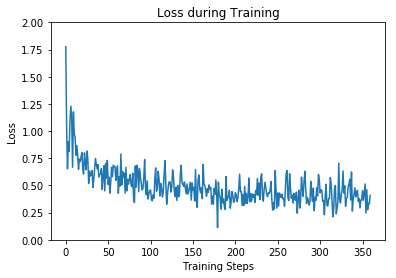

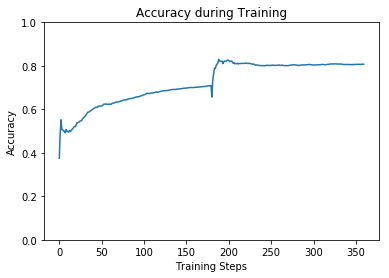

In [162]:
plt.figure()
plt.title("Loss during Training")
plt.ylabel("Loss")
plt.xlabel("Training Steps")
plt.ylim([0,2])
plt.plot(batch_stats.batch_losses)

plt.figure()
plt.title("Accuracy during Training")
plt.ylabel("Accuracy")
plt.xlabel("Training Steps")
plt.ylim([0,1])
plt.plot(batch_stats.batch_acc)

## Evaluating the model on the Validation Set

In the code below, we test our trained model on the "validation_data" and present the validation accuracy. 

In [15]:
valid_scores = []
count_ = 0
num_batch = len(validation_data.filenames) // 32
validation_data.reset() # resetting the generator so that we always get the same set of images for validation
for x_test, y_test in validation_data:
    scores = model.evaluate(x_test, y_test, verbose=1)
    valid_scores.append(scores)
    count_ += 1
    if count_ >= num_batch:
        break
print("validation accuracy", np.mean(list((uu[1] for uu in valid_scores))))

32/32 [==============================] - 1s 21ms/sample - loss: 0.2117 - acc: 0.9062
validation accuracy 0.80745965


### Analyzing the results

To redo the plot from before, we first get the ordered list of class names:

In [17]:
label_names = sorted(validation_data.class_indices.items(), key=lambda pair:pair[1])
label_names = np.array([key.title() for key, value in label_names])
label_names

array(['Istanbul', 'Taipei'], dtype='<U8')

Next, we run the image batch through the model and convert the indices to class names. We pick random batches, in the below case we picked the 15th and 26th batches. 

In [18]:
validation_data.reset()

true_image_batch_1, true_label_batch_1 = validation_data[14]
true_image_batch_2, true_label_batch_2 = validation_data[25]

predicted_batch_1 = model.predict(true_image_batch_1)
predicted_batch_2 = model.predict(true_image_batch_2)

labels_predicted_batch_1 = label_names[np.argmax(predicted_batch_1, axis=-1)]
labels_predicted_batch_2 = label_names[np.argmax(predicted_batch_2, axis=-1)]
print(labels_predicted_batch_1)
print(labels_predicted_batch_2)

['Istanbul' 'Istanbul' 'Istanbul' 'Istanbul' 'Istanbul' 'Istanbul'
 'Istanbul' 'Istanbul' 'Istanbul' 'Istanbul' 'Istanbul' 'Istanbul'
 'Taipei' 'Istanbul' 'Istanbul' 'Taipei' 'Istanbul' 'Istanbul' 'Istanbul'
 'Taipei' 'Istanbul' 'Istanbul' 'Istanbul' 'Taipei' 'Istanbul' 'Istanbul'
 'Taipei' 'Istanbul' 'Taipei' 'Taipei' 'Istanbul' 'Istanbul']
['Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei'
 'Taipei' 'Taipei' 'Istanbul' 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei'
 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Istanbul' 'Taipei'
 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei' 'Taipei']


### Plotting the results for arbitrarily chosen batches
In the code below, we plot the results for the images in the 15th and 26th batches. We picked those batches randomly. The images with the incorrect predictions have captions in red color.

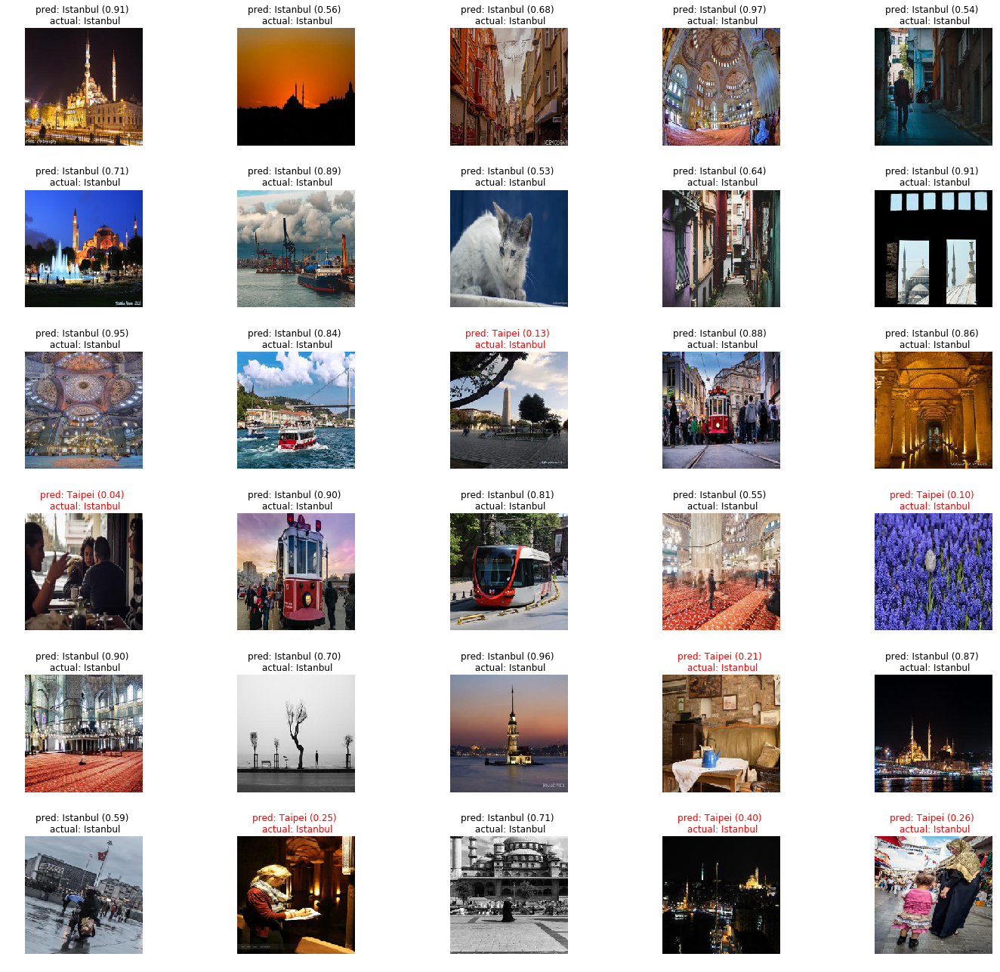

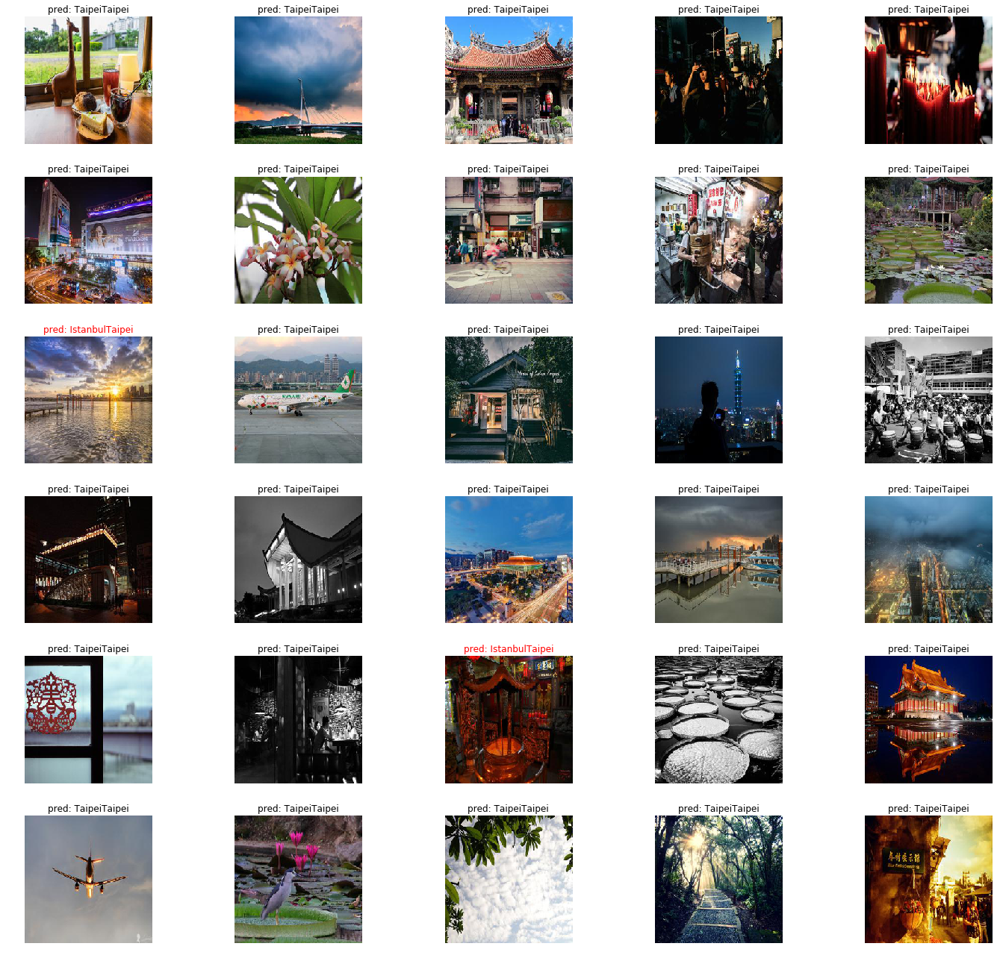

In [19]:
fig = plt.figure(figsize=(20,18))
for n in range(30):
    plt.subplot(6,5,n+1)
    plt.imshow(true_image_batch_1[n])
    prob = predicted_batch_1[n, 0]
    if prob < 0.5:
        titleColor = 'r'
    else:
        titleColor = 'k'

    titleObj = plt.title("pred: " + str(labels_predicted_batch_1[n]) + f" ({prob:.2f}) \n actual: " + label_names[int(true_label_batch_1[n][1])] )
    plt.setp(titleObj, color=titleColor)
    plt.axis('off')

fig.tight_layout()

fig = plt.figure(figsize=(20,18))
for n in range(30):
    plt.subplot(6,5,n+1)
    plt.imshow(true_image_batch_2[n])
    prob = predicted_batch_2[n, 0]
    if (prob > 0.5):
        titleColor = 'r'
    else:
        titleColor = 'k'
    titleObj = plt.title("pred: " + str(labels_predicted_batch_2[n])  + label_names[int(true_label_batch_2[n][1])] )
    plt.setp(titleObj, color=titleColor)
    plt.axis('off')

fig.tight_layout()

In [20]:
validation_data.reset()
count_ = 0
num_batch = len(validation_data.filenames) // 32
true_labels = []
predictions = []
for image_batch, true_labels_batch in validation_data:
    count_ += 1
    predictions_batch = model.predict(image_batch)
    true_labels.append(true_labels_batch)
    predictions.append(predictions_batch)
    if count_ > num_batch:
        break


In [21]:
predictions_stacked = np.vstack(predictions)
true_labels_stacked = np.vstack(true_labels)
prob_istanbul=predictions_stacked[:,0]
true_istanbul=true_labels_stacked[:,0]
print(prob_istanbul) #the prediction probablity of being image=istanbul
print(true_istanbul) # 1 represents=Istanbul, 0 represents=Taipei 

[0.80615354 0.6238848  0.7269538  ... 0.28109157 0.05030642 0.4505954 ]
[1. 1. 1. ... 0. 0. 0.]


### Confusion Matrix

In [22]:
predicted_istanbul=[None]*len(prob_istanbul)
actual_istanbul=[None]*len(true_istanbul)
for i in np.arange(len(true_istanbul)):
    if (prob_istanbul[i] >0.5): #threshold value is taken as 0.5
        predicted_istanbul[i]="Istanbul"  
    else:
        predicted_istanbul[i]="Taipei"
for i in np.arange(len(true_istanbul)):
    if (true_istanbul[i]==1):
        actual_istanbul[i]="Istanbul"  
    else:
        actual_istanbul[i]="Taipei"
     

In [23]:
import pandas as pd
actual = actual_istanbul
predicted = predicted_istanbul
df = pd.DataFrame({'predicted':predicted,'actual':actual})

pd.crosstab(df['predicted'],df['actual'])

actual,Istanbul,Taipei
predicted,,
Istanbul,364,49
Taipei,144,459


In [24]:
true_positive=0; true_negative=0
false_positive=0; false_negative=0

for i in np.arange(len(actual_istanbul)):
    if (actual_istanbul[i]=="Istanbul") and (predicted_istanbul[i]=="Istanbul"):
        true_positive+= 1
    elif (actual_istanbul[i]=="Taipei") and (predicted_istanbul[i]=="Istanbul"):
        false_negative+= 1
    elif (actual_istanbul[i]=="Taipei") and (predicted_istanbul[i]=="Taipei"):
        true_negative+= 1
    else:
        false_positive+= 1

accuracy= (true_positive+true_negative)/(true_negative+true_positive+false_positive+false_negative)   
sensitivity=(true_positive)/(true_positive+false_negative)
specificity=(true_negative)/(true_negative+false_positive)
print("Accuracy: " +str(accuracy))
print("Sensitivity: "+str(sensitivity))
print("Specificity: "+str(specificity))


Accuracy: 0.8100393700787402
Sensitivity: 0.8813559322033898
Specificity: 0.7611940298507462


# Adding More Dense Layers

In order to increase the accuracy, we tried adding more dense layers. We started with adding one and obtained "model_2" and added one more and obtained "model_3". As observed, the loss and the accuracy have been improved as compared to "model".

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


I0312 00:29:23.731742 140736151036800 saver.py:1483] Saver not created because there are no variables in the graph to restore


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lambda (Lambda)              (None, 1280)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 100)               128100    
_________________________________________________________________
dense_2 (Dense)              (None, 2)                 202       
Total params: 128,302
Trainable params: 128,302
Non-trainable params: 0
_________________________________________________________________
Epoch 1/2
180/180 [==============================] - 125s 695ms/step - loss: 0.4749 - acc: 0.7675
Epoch 2/2
32/32 [==============================] - 1s 21ms/sample - loss: 0.2682 - acc: 0.8750
validation accuracy 0.8548387


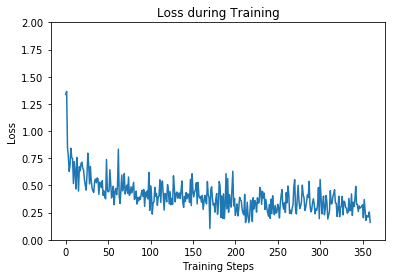

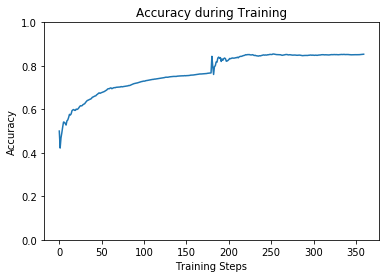

In [27]:
model_2 = tf.keras.Sequential([
  features_extractor_layer, 
  layers.Dense(100, activation='relu'),
  layers.Dense(training_data.num_classes, activation='softmax')
])
model_2.summary()

sess = tf.keras.backend.get_session() #get the session created by keras
init = tf.global_variables_initializer()
sess.run(init)

result = model_2.predict(image_batch)

model_2.compile(
  optimizer=tf.train.AdamOptimizer(), 
  loss='categorical_crossentropy', #the loss function
  metrics=['accuracy'])

steps_per_epoch = training_data.samples//training_data.batch_size
batch_stats = CollectBatchStats()
model_2.fit((item for item in training_data), epochs=2, # Our experiments show that the accuracy does not improve after 2 epochs
                    steps_per_epoch=steps_per_epoch,
                    callbacks = [batch_stats])

valid_scores = []
count_ = 0
num_batch = len(validation_data.filenames) // 32
validation_data.reset() # resetting the generator so that we always get the same set of images for validation
for x_test, y_test in validation_data:
    scores = model_2.evaluate(x_test, y_test, verbose=1)
    valid_scores.append(scores)
    count_ += 1
    if count_ >= num_batch:
        break
print("validation accuracy", np.mean(list((uu[1] for uu in valid_scores))))

plt.figure()
plt.title("Loss during Training")
plt.ylabel("Loss")
plt.xlabel("Training Steps")
plt.ylim([0,2])
plt.plot(batch_stats.batch_losses)

plt.figure()
plt.title("Accuracy during Training")
plt.ylabel("Accuracy")
plt.xlabel("Training Steps")
plt.ylim([0,1])
plt.plot(batch_stats.batch_acc)


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


I0312 00:34:07.125448 140736151036800 saver.py:1483] Saver not created because there are no variables in the graph to restore


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lambda (Lambda)              (None, 1280)              0         
_________________________________________________________________
dense_3 (Dense)              (None, 150)               192150    
_________________________________________________________________
dense_4 (Dense)              (None, 100)               15100     
_________________________________________________________________
dense_5 (Dense)              (None, 2)                 202       
Total params: 207,452
Trainable params: 207,452
Non-trainable params: 0
_________________________________________________________________
Epoch 1/2
180/180 [==============================] - 124s 686ms/step - loss: 0.4498 - acc: 0.7762
Epoch 2/2
32/32 [==============================] - 1s 22ms/sample - loss: 0.2125 - acc: 0.9062
validation accuracy 0.8427419


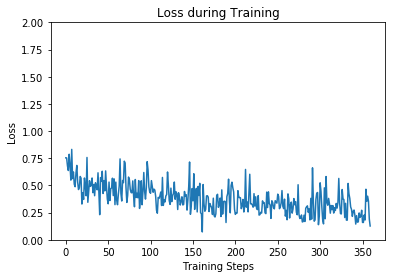

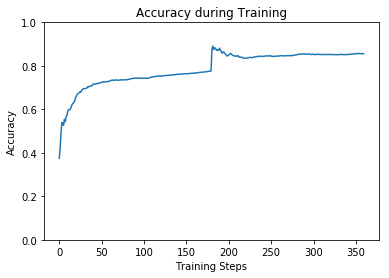

In [28]:
model_3 = tf.keras.Sequential([
  features_extractor_layer,
  layers.Dense(150, activation='relu'), 
  layers.Dense(100, activation='relu'),
  layers.Dense(training_data.num_classes, activation='softmax')
])
model_3.summary()

sess = tf.keras.backend.get_session() #get the session created by keras
init = tf.global_variables_initializer()
sess.run(init)

result = model_3.predict(image_batch)

model_3.compile(
  optimizer=tf.train.AdamOptimizer(), 
  loss='categorical_crossentropy', #the loss function
  metrics=['accuracy'])

steps_per_epoch = training_data.samples//training_data.batch_size
batch_stats = CollectBatchStats()
model_3.fit((item for item in training_data), epochs=2, # Our experiments show that the accuracy does not improve after 2 epochs
                    steps_per_epoch=steps_per_epoch,
                    callbacks = [batch_stats])

valid_scores = []
count_ = 0
num_batch = len(validation_data.filenames) // 32
validation_data.reset() # resetting the generator so that we always get the same set of images for validation
for x_test, y_test in validation_data:
    scores = model_3.evaluate(x_test, y_test, verbose=1)
    valid_scores.append(scores)
    count_ += 1
    if count_ >= num_batch:
        break
print("validation accuracy", np.mean(list((uu[1] for uu in valid_scores))))

plt.figure()
plt.title("Loss during Training")
plt.ylabel("Loss")
plt.xlabel("Training Steps")
plt.ylim([0,2])
plt.plot(batch_stats.batch_losses)

plt.figure()
plt.title("Accuracy during Training")
plt.ylabel("Accuracy")
plt.xlabel("Training Steps")
plt.ylim([0,1])
plt.plot(batch_stats.batch_acc)


# Displaying the model graph using TensorBoard

We would like to present model graph (using Tensorboard) here in jupyter notebook. We need to use import "tensorboard_notebook2" which can be found:
https://github.com/tensorflow/tensorflow/blob/master/tensorflow/examples/tutorials/deepdream/deepdream.ipynb

When we run the code below, the graph looks small and complicated. We zoom in to see the details.

In [30]:
import tensorboard_notebook2 as tbnb

In [31]:
tbnb.show_graph(tf.get_default_graph().as_graph_def())

# Conclusion

We studied three models and observed that increasing the number of dense layers minimized the loss and increased the accuracy. Since there was not a big improvement between adding one dense layer and two dense layers around (both around 85 %), we decided to stop adding more layers. Inside the dense layers, we picked the numbers $100$ and $150$ randomly. One can try other numbers to check if there is any improvement. 

As we proposed at the beginning, by using Convolutional Deep Neural Networks, we achieved our aim and we beat the 50% baseline by obtaining about 85% accuracy.